In [1]:

import os
import sys

sys.path.append('../light-weight-refinenet/')

import six
from models.resnet import rf_lw101, rf_lw152
from utils.helpers import prepare_img


import glob

import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
import imageio
import colorsys


from PIL import Image

In [2]:

from pathlib import Path
import argparse
import random
import numpy as np
import matplotlib.cm as cm
import torch
from skimage.exposure import match_histograms
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import MeanShift,KMeans
from tqdm.notebook import tqdm
from scipy.spatial import ConvexHull
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

import os
import sys

sys.path.append('../')

from SuperGluePretrainedNetwork.models.matching import Matching
from SuperGluePretrainedNetwork.models.utils import (compute_pose_error, compute_epipolar_error,
                          estimate_pose, make_matching_plot,
                          error_colormap, AverageTimer, pose_auc, read_image,
                          rotate_intrinsics, rotate_pose_inplane,
                          scale_intrinsics)
device = 'cuda' if torch.cuda.is_available() and not opt.force_cpu else 'cpu'

In [3]:
NMS_RADIUS = 4
KEYPOINT_THRESHOLD = 5e-4
MAX_KEYPOINTS = 4096*4
WEIGHTS = 'outdoor'
SINKHORN_ITERATIONS = 100
MATCH_THRESHOLD = 0.2
RESIZE = [1600]
RESIZE_FLOAT = True
ROT0 = 0
ROT1 = 0

config = {
        'superpoint': {
            'nms_radius': NMS_RADIUS,
            'keypoint_threshold': KEYPOINT_THRESHOLD,
            'max_keypoints': MAX_KEYPOINTS
        },
        'superglue': {
            'weights': WEIGHTS,
            'sinkhorn_iterations': SINKHORN_ITERATIONS,
            'match_threshold': MATCH_THRESHOLD,
        },
    'r2d2': {
        'gpu': -1,
        'model': '../r2d2/models/r2d2_WASF_N16.pt',
        'reliability_thr': 0.7,
        'repeatability-thr':0.7,
        'top-k':MAX_KEYPOINTS,
        'scale-f':2**0.25,
        'min-size':256,
        'max-size':RESIZE[0],
        'min-scale':0,
        'max-scale':1,
        'resize':RESIZE,
        'nms_radius': NMS_RADIUS,
            'keypoint_threshold': KEYPOINT_THRESHOLD,
            'max_keypoints': MAX_KEYPOINTS
    }
    }

matching = Matching(config).eval().to(device)
torch.set_grad_enabled(False)

Loaded SuperPoint model
Loaded SuperGlue model ("outdoor" weights)


In [4]:
plt.rcParams['figure.figsize'] = (40,40)
%matplotlib inline


In [5]:
import math
import random
import collections
import os
import sys
import functools
import operator as op
import numpy as np
import warnings

from scipy.spatial import cKDTree as KDTree
from skimage.filters.rank import entropy
from skimage.morphology import disk, dilation
from skimage.util import img_as_ubyte
from skimage.io import imread, imsave
from skimage.color import rgb2gray, rgb2lab, lab2rgb
from skimage.filters import sobel, gaussian
from skimage.restoration import denoise_bilateral
from skimage.transform import downscale_local_mean


# Returns a random real number in half-open range [0, x).
def rand(x):
    r = x
    while r == x:
        r = random.uniform(0, x)
    return r


def poisson_disc(img, n, k=30):
    h, w = img.shape[:2]

    nimg = denoise_bilateral(img,sigma_spatial=15,multichannel=True)
    img_gray = rgb2gray(nimg)
    img_lab = rgb2lab(nimg)

    entropy_weight = 2**(entropy(img_as_ubyte(img_gray), disk(15)))
    entropy_weight /= np.amax(entropy_weight)
    entropy_weight = gaussian(dilation(entropy_weight, disk(15)), 5)


    color = [sobel(img_lab[:, :, channel])**2 for channel in range(1, 3)]
    edge_weight = functools.reduce(op.add, color) ** (1/2) / 75
    edge_weight = dilation(edge_weight, disk(5))
    


    weight = (0.6*entropy_weight + 0.7*edge_weight)
    weight /= np.mean(weight)
    weight = weight

    max_dist = min(h, w) / 16
    avg_dist = math.sqrt(w * h / (n * math.pi * 0.5) ** (1.05))
    min_dist = avg_dist / 16

    dists = np.clip(avg_dist / weight, min_dist, max_dist)


    def gen_rand_point_around(point):
        radius = random.uniform(dists[int(point[0])][[int(point[1])]], max_dist)
        angle = rand(2 * math.pi)
        offset = np.array([radius * math.sin(angle), radius * math.cos(angle)])
        point = np.array(point)
        point[0] += offset[0]
        point[1] += offset[1]
        return tuple(point)

    def has_neighbours(point):
        point_dist = dists[int(point[0])][[int(point[1])]]
        distances, idxs = tree.query(point,
                                    len(sample_points) + 1,
                                    distance_upper_bound=max_dist)

        if len(distances) == 0:
            return True

        for dist, idx in zip(distances, idxs):
            if np.isinf(dist):
                break
                
            if dist < point_dist[0] and dist < dists[int(tree.data[idx][0])][int(tree.data[idx][1])]:
                return True

        return False

    # Generate first point randomly.
    first_point = [rand(h), rand(w)]
    to_process = [first_point]
    sample_points = [first_point]
    tree = KDTree(sample_points)

    while to_process:
        # Pop a random point.
        point = to_process.pop(random.randrange(len(to_process)))

        for _ in range(k):

            new_point = gen_rand_point_around(point)

            if (0 <= new_point[0] < h and 0 <= new_point[1] < w
                    and not has_neighbours(new_point)):
                to_process.append(new_point)
                sample_points.append(new_point)
                tree = KDTree(sample_points)
                if len(sample_points) % 1000 == 0:
                    print("Generated {} points.".format(len(sample_points)))

    print("Generated {} points.".format(len(sample_points)))

    return sample_points


def sample_colors(img, sample_points, n,downsample=True):
    h, w = img.shape[:2]

    print("Sampling colors...")

    tree = KDTree(np.array(sample_points, dtype=np.float32).tolist())
    color_samples = collections.defaultdict(list)
    img_lab = rgb2lab(img)
    xx, yy = np.meshgrid(np.arange(h), np.arange(w))
    pixel_coords = np.c_[xx.ravel(), yy.ravel()]
    nearest = tree.query(pixel_coords)[1]

    i = 0
    for pixel_coord in pixel_coords:
        color_samples[tuple(tree.data[nearest[i]])].append(
            img_lab[tuple(pixel_coord)])
        i += 1

    print("Computing color means...")
    samples = []
    for point, colors in color_samples.items():
        avg_color = np.sum(colors, axis=0) / len(colors)
        samples.append(np.append(point, avg_color))
        
    if downsample:
        if len(samples) > n:
            print("Downsampling {} to {} points...".format(len(samples), n))

        while len(samples) > n:
            tree = KDTree(np.array(samples))
            dists, neighbours = tree.query(np.array(samples), 2)
            dists = dists[:, 1]
            worst_idx = min(range(len(samples)), key=lambda i: dists[i])

            samples[neighbours[worst_idx][1]] += samples[neighbours[worst_idx][0]]
            samples[neighbours[worst_idx][1]] /= 2
            samples.pop(neighbours[worst_idx][0])

    color_samples = []
    for sample in samples:
        color = lab2rgb([[sample[2:]]])[0][0]
        color_samples.append(tuple(sample[:2][::-1]) + tuple(color))

    return color_samples


def render(img, color_samples):
    print("Rendering...")
    h, w = [x for x in img.shape[:2]]
    xx, yy = np.meshgrid(np.arange(h), np.arange(w))
    pixel_coords = np.c_[xx.ravel(), yy.ravel()]

    colors = np.empty([h, w, 3])
    coords = []
    for color_sample in color_samples:
        coord = [x for x in color_sample[:2][::-1]]
        
        #r = np.random.random_sample()
        colors[int(coord[0]),int(coord[1])] = [color_sample[2],color_sample[3],color_sample[4]]
        coords.append([int(coord[0]),int(coord[1])])

    tree = KDTree(coords)
    idxs = tree.query(pixel_coords)[1]
    data = colors[tuple(tree.data[idxs].astype(int).T)].reshape((w, h, 3))
    data = np.transpose(data, (1, 0, 2))

    return data


In [15]:
def create_marked_img(mask_img,mask_lable):
    mask_img_test = mask_img.copy()
    marked_img = np.zeros([mask_img_test.shape[0],mask_img_test.shape[1]],dtype=int)

    for i in range(marked_img.shape[0]):
        for j in range(marked_img.shape[1]):
            if mask_img_test[i,j].tolist() in mask_lable:
                index = mask_lable.index(mask_img_test[i,j].tolist())
                marked_img[i,j]=index
    return marked_img

def create_marked_img_test(mask_lable,mask_img,marked_img):
    mask_lable_new = np.array(mask_lable)
    mask_img_test = mask_img.copy()
    marked_img_test = marked_img.copy()
    for i in range(marked_img.shape[0]-1):
        for j in range(marked_img.shape[1]-1):
            if abs(int(mask_img_test[i,j][0]) - int(mask_img_test[i,j+1][0]))<25 and\
            abs(int(mask_img_test[i,j][1]) - int(mask_img_test[i,j+1][1]))<25:
                indx1 = mask_lable.index(mask_img[i,j].tolist())
                indx2 = mask_lable.index(mask_img[i,j+1].tolist())
                marked_img_test[marked_img_test==int(indx2)] = int(indx1)
    
    return marked_img_test

def calculate_result_marked_mask(marked_img_test,mask_img):
    
    marked_img_test_result = marked_img_test.copy()

    mask_img_test = mask_img.copy()

    for _ in range(3):
        marked_img_test_result = marked_img_test_result.copy()
        lable_test = np.unique(marked_img_test_result.reshape(-1), axis=0)

        mean = []
        for index_class in lable_test:

            mean.append(len(marked_img_test_result[marked_img_test_result==index_class]))

        median_value = int(np.mean(np.array(mean))*1.2)

        print("calculate area")

        for index_class in lable_test:

            pixel_value = len(marked_img_test_result[marked_img_test_result==index_class])
            if pixel_value<median_value:

                friend_class = []
                mask_data =np.zeros(marked_img_test.shape)
                mask_data[marked_img_test==index_class]=255
                
                real_color = []
                for i in range(1,mask_data.shape[0]-1):
                    for j in range(1,mask_data.shape[1]-1):

                        if mask_data[i,j]==255:
                            real_color=mask_img_test[i,j]

                            if [i+1,j] not in friend_class and mask_data[i+1,j]!=255:
                                friend_class.append([i+1,j])

                            elif [i+1,j+1] not in friend_class and mask_data[i+1,j+1]!=255:
                                friend_class.append([i+1,j+1])

                            elif [i,j+1] not in friend_class and mask_data[i,j+1]!=255:
                                friend_class.append([i,j+1])

                            elif [i-1,j] not in friend_class and mask_data[i-1,j]!=255:
                                friend_class.append([i-1,j])

                            elif [i-1,j-1] not in friend_class and mask_data[i-1,j-1]!=255:
                                friend_class.append([i-1,j-1])

                            elif [i,j-1] not in friend_class and mask_data[i,j-1]!=255:
                                friend_class.append([i,j-1])

                            elif [i-1,j+1] not in friend_class and mask_data[i-1,j+1]!=255:
                                friend_class.append([i-1,j+1])

                            elif [i+1,j-1] not in friend_class and mask_data[i+1,j-1]!=255:
                                friend_class.append([i+1,j-1])

                if len(friend_class)>0:

                    hsv_real_color = colorsys.rgb_to_hsv(real_color[0],real_color[1],real_color[2])
                    min_v = 360
                    min_h=100
                    arg=1000
                    find_color_indx=None

                    for frd_cls in friend_class:
                        colr = mask_img_test[frd_cls[0],frd_cls[1]]
                        hsv_color = colorsys.rgb_to_hsv(colr[0],colr[1],colr[2])
                        if (abs(hsv_color[0]-hsv_real_color[0])-min_v + abs(hsv_color[2]-hsv_real_color[2])-min_h)/2<arg:
                            min_v = abs(hsv_color[0]-hsv_real_color[0])
                            min_h = abs(hsv_color[2]-hsv_real_color[2])
                            arg=(abs(hsv_color[0]-hsv_real_color[0])-min_v + abs(hsv_color[2]-hsv_real_color[2])-min_h)/2
                            find_color_indx=frd_cls
                    if frd_cls is None:
                        find_color_indx=friend_class[0]
                        
                    marked_img_test_result[marked_img_test_result==index_class]=marked_img_test_result[find_color_indx[0],find_color_indx[1]]

    
    return marked_img_test_result

def preproc_mask(marked_mask0):
    
    marked_mask = marked_mask0.copy()
    
    class_value =0
    
    for index_class in range(len(np.unique(marked_mask.reshape(-1)).tolist())):
        
        mask = np.zeros(marked_mask.shape, dtype=np.uint8)
        mask[marked_mask==index_class]=255
    
        ret, thresh = cv2.threshold(mask, 50, 255, cv2.THRESH_BINARY)
        im, contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        
        for cntr in contours:
            x,y,w,h = cv2.boundingRect(cntr)
            new_data = mask[y:y+h,x:x+w]
            
            marked_mask[y:y+h,x:x+w][mask[y:y+h,x:x+w]==255]=class_value
            
            class_value+=1
            
    return marked_mask

def calculate_marked_mask(image):
    
    print("calculate mask...")

    weight, height,_ = image.shape
    image = cv2.resize(image,(image.shape[1]//10,image.shape[0]//10))
    sample_points = poisson_disc(image, 1000)
    samples = sample_colors(image, sample_points,300,True)
    print(image.shape)
    mask_img = (render(image, samples)*255.).astype(np.uint8)
    
    print("end render")
    
    #mask_img = cv2.resize(mask_img,(height,weight), interpolation=cv2.INTER_NEAREST)
    print(mask_img.shape)
    plt.imshow(mask_img)
    plt.show()
    #mask_lable = np.unique(mask_img.reshape(-1,3), axis=0).tolist()
    
    mask_lable = []
    test_im = mask_img.reshape(-1,3).tolist()
    for i in range(len(test_im)):

        if i==0:
            mask_lable.append(test_im[i])
        elif test_im[i] not in mask_lable:
            mask_lable.append(test_im[i])
        
    print("lable len: "+str(len(mask_lable)))
    marked_img = create_marked_img(mask_img,mask_lable)
    
    print("preproc mask...")
    marked_img = preproc_mask(marked_img)
    
    marked_img_test = create_marked_img_test(mask_lable,mask_img,marked_img)
    
    
    
    marked_img_test_result = calculate_result_marked_mask(marked_img_test,mask_img)

    return marked_img_test_result

calculate mask...
Generated 1000 points.
Generated 1955 points.
Sampling colors...
Computing color means...
Downsampling 1955 to 100 points...
(364, 547, 3)
Rendering...
end render
(364, 547, 3)


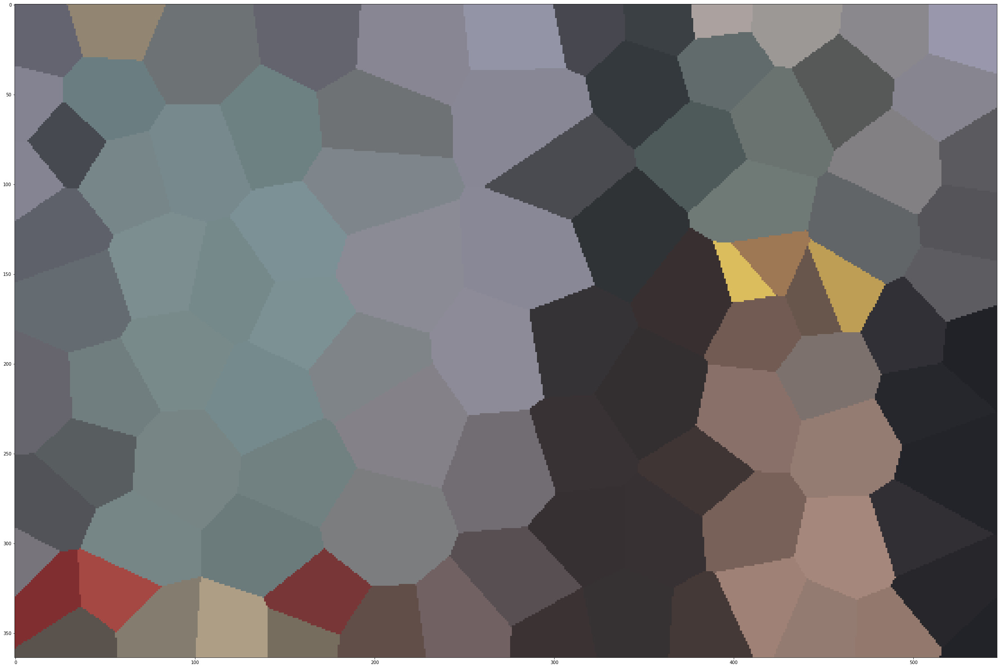

lable len: 100


Lossy conversion from int64 to uint8. Range [0, 99]. Convert image to uint8 prior to saving to suppress this warning.


preproc mask...


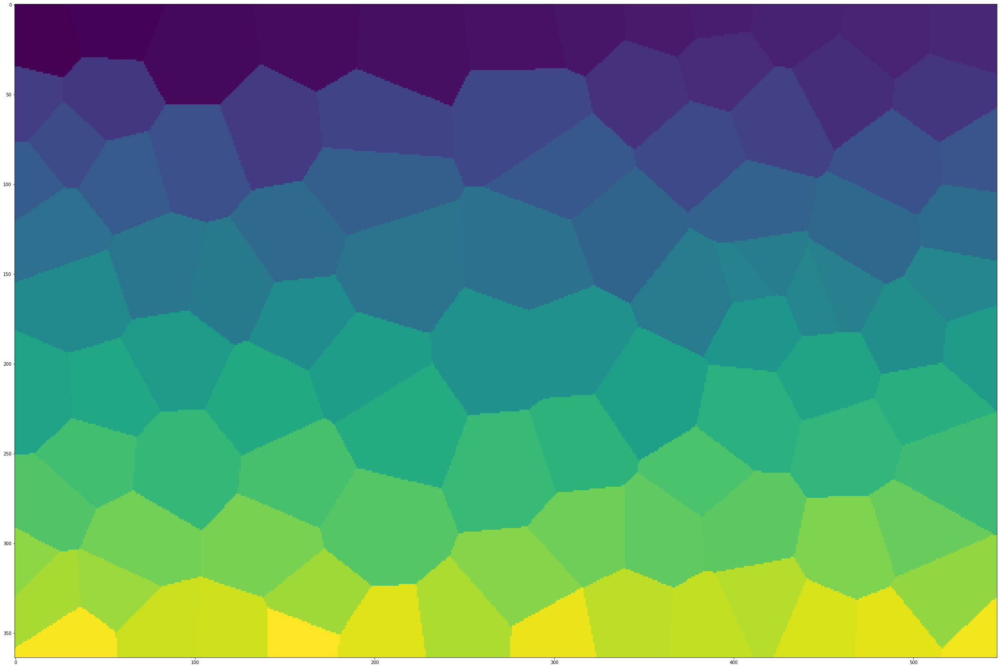

Transforme...


[]
[]
[ 57  62  93  94 122 150 157 170 187 203 204 206 221 227 230 241 244 253
 264 274 277 280 281 293 298 302 304 307 308 325 329 345 350 356 357 363
 368 372 389 392 397 401 408 418]
[  7  87 228 260]
[218 222 245 246 283 295 305 313 321]
[  3  88 167 180 242 267 309 314 327]
[  0   1   2   4   5   6   8   9  10  12  15  16  20  21  23  28  30  31
  32  36  38  39  41  42  45  47  48  49  54  55  58  59  63  66  75  78
  79  80  81  82  83  89  97  98 102 109 110 116 125 126 130 131 134 135
 140 141 142 143 153 155 156 158 159 163 164 168 169 171 172 176 177 178
 184 189 200 210 231 233 234 238 239 296]
[ 11  13  14  17  18  19  22  24  26  27  33  34  68  99 103 104 111 112
 117 123 136 148 151 154 191 193 194 195 196 197 207 208 212 225 226 232
 235 268 269 270]
[ 25  29  35  40  43  52  60  64  73  76  84  90  95 113 118 127 132 138
 145 160 201 205]
[ 37  44  46  50  51  53  56  65  67  69  70  71  72  74  85  91  92  96
 105 106 107 114 115 119 120 121 124 128 129 133 137 139 1

[1799 1824 1849 1858 1868 1887 1900 1910 2002 2010 2051 2110 2123 2129
 2137 2162 2163 2167 2196 2235]
[1649 1655 1681 1690 1694 1703 1704 1705 1710 1717 1725 1731 1732 1735
 1737 1738 1739 1763 1769 1770 1777 1778 1798 1801 1809 1812 1816 1820
 1826 1832 1843 1845 1861 1881 1886 1889 1892 1893 1894 1895 1903 1904
 1905 1914 1970 1974 2008 2017 2020 2024 2026 2034 2035 2040 2045]
[]
[1718 1844 1851 1854 1978 2146]
[1633 1634 1670 1679 1682 1684 1701 1722 1724 1745 1750 1752 1759 1775
 1781 1791 1792 1822 1827 1830 1833 1839 1848 1864 1865 1867 1870 1872
 1874 1877 1909 1915 1917 1918 1928 1929 1950 1954 1957 1958 1964 1965
 1967 1985 1987 1991 1993 1994 1999 2001 2005 2021 2022 2023 2030 2039
 2071 2073 2080 2082 2083 2086 2087 2090 2109 2119 2120 2128 2132 2157
 2158 2200 2207 2241 2246 2254]
[1800 1806 1814 1828 1883 1885 1888 1891 1901 1902 1906 1907 1908 1911
 1912 1913 1934 1955 1956 1968 1969 1973 1982 1983 1995 2018 2027 2031
 2033 2036 2042 2043 2044 2047 2049 2052 2053 2057 20

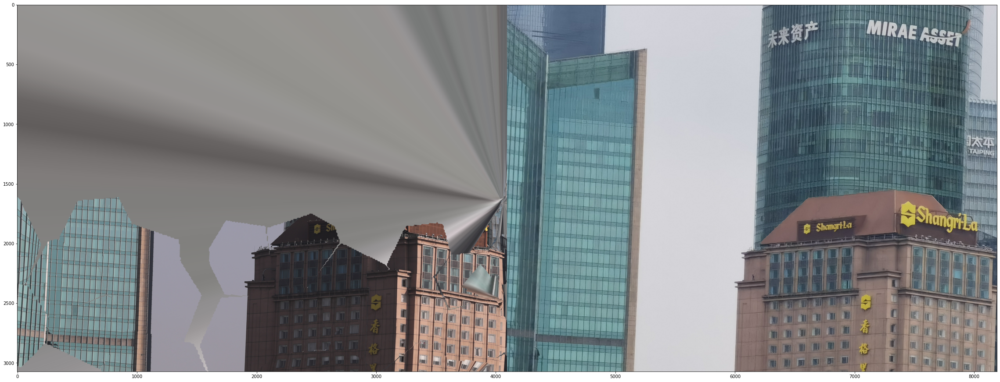

In [68]:
transformed_image0 = pipeline(mkpts0, mkpts1, image0, image1)
plt.imshow(np.concatenate([transformed_image0,image0],axis=1))
plt.show()

calculate mask...
Generated 1000 points.
Generated 1955 points.
Sampling colors...
Computing color means...
Downsampling 1955 to 1000 points...
(364, 547, 3)
Rendering...
end render
(364, 547, 3)


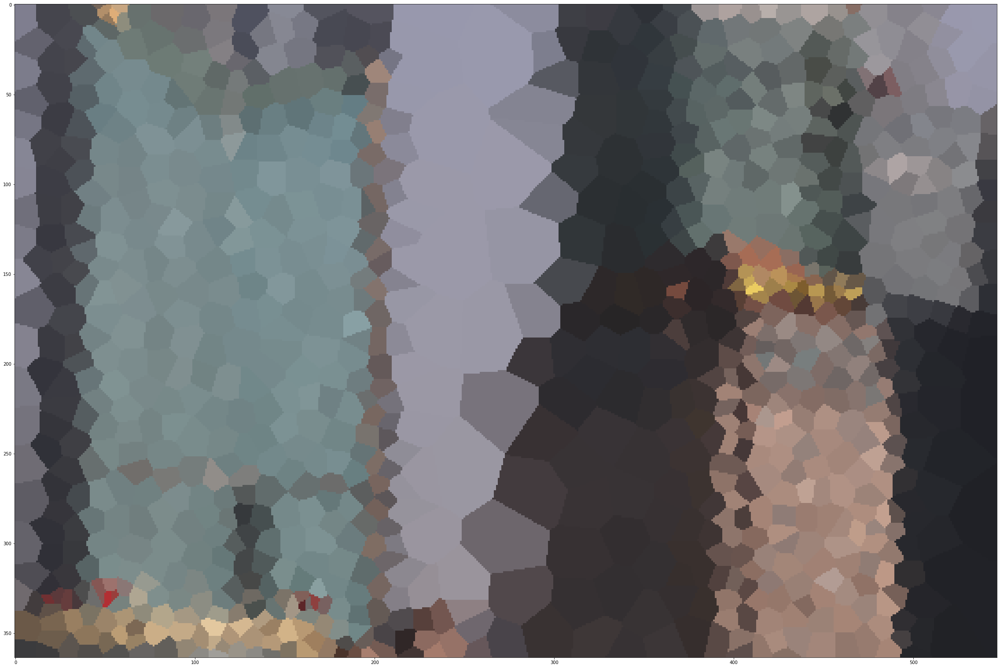

lable len: 962
preproc mask...
calculate area


/home/ekaterina/Work/environments/myvenv1/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning: overflow encountered in ubyte_scalars
/home/ekaterina/Work/environments/myvenv1/lib/python3.7/site-packages/ipykernel_launcher.py:98: RuntimeWarning: overflow encountered in ubyte_scalars
/home/ekaterina/Work/environments/myvenv1/lib/python3.7/site-packages/ipykernel_launcher.py:99: RuntimeWarning: overflow encountered in ubyte_scalars


calculate area
calculate area
calculate area
calculate area


Lossy conversion from int64 to uint8. Range [1, 1931]. Convert image to uint8 prior to saving to suppress this warning.


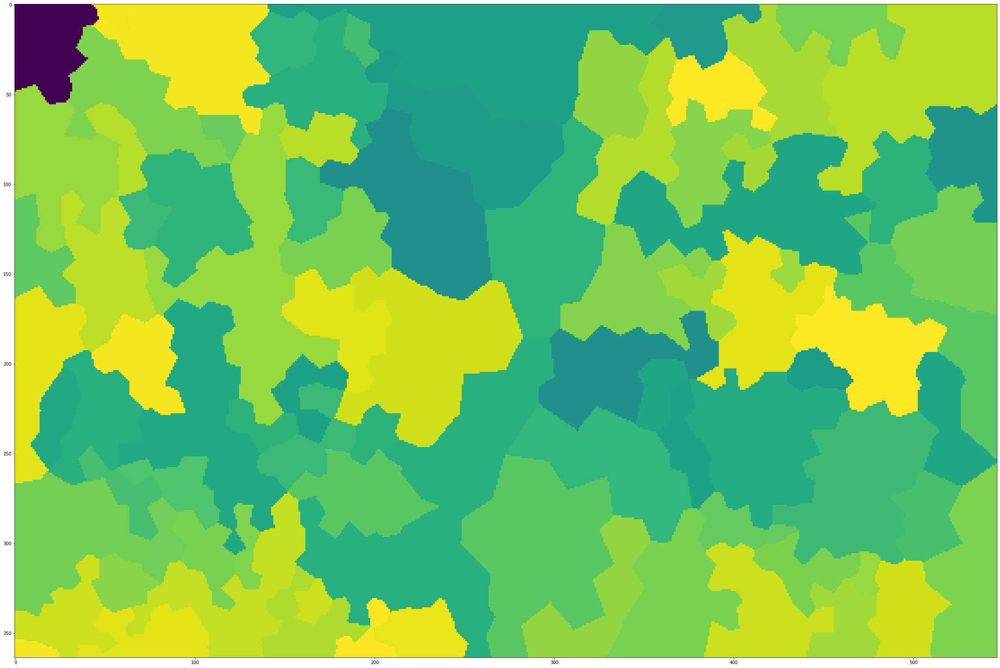

Transforme...


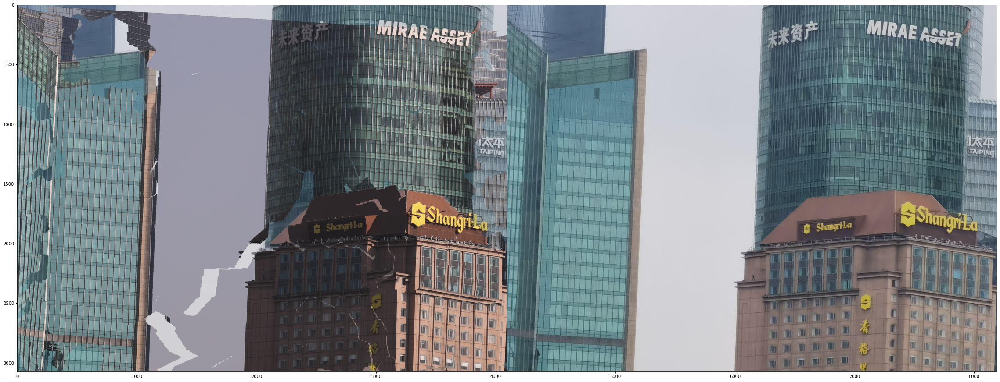

In [49]:
transformed_image0 = pipeline(mkpts0, mkpts1, image0, image1)
plt.imshow(np.concatenate([transformed_image0,image0],axis=1))
plt.show()

In [147]:
mkpts1.min()

27.351452

In [213]:
M = np.float32([[ 1.82350188e-01, -4.77248396e-01, -3.96421168e+01],
                [ 3.37217023e-02, -1.03755526e+00,  2.71694744e+02],
                [ 1.55730427e-04, -3.95081404e-03,  1.00000000e+00]])
p1 = np.float32([[1012.32,     201.71696],[ 937.08,     218.81161],[1012.32,     218.81161],
                 [1053.36,     232.48735],[ 943.92,     263.25772],[ 974.7,      280.3524 ]])
p2= np.float32([[140.8,  243.2 ],[ 61.44, 245.76],[138.24, 268.8 ],[168.96, 268.8 ],[ 64.,   284.16],[ 97.28, 309.76]])




In [214]:
p=np.concatenate([p1,np.zeros((p1.shape[0],1))],axis=-1)[0]

In [215]:
p[0]

1012.3200073242188

In [216]:
p2[0]

array([140.8, 243.2], dtype=float32)

In [179]:
np.dot(p[0],np.linalg.inv(M))

array([ 1.54448858e+06,  1.41325785e+06, -5.46172111e+09])

In [222]:
matrix=M

In [221]:
p

array([1012.32000732,  201.71696472,    0.        ])

In [223]:
px = (matrix[0][0]*p[0] + matrix[0][1]*p[1] + matrix[0][2]) / ((matrix[2][0]*p[0] + matrix[2][1]*p[1] + matrix[2][2]))
py = (matrix[1][0]*p[0] + matrix[1][1]*p[1] + matrix[1][2]) / ((matrix[2][0]*p[0] + matrix[2][1]*p[1] + matrix[2][2]))

In [224]:
px

134.97409516532014

In [225]:
py

267.64252844980336

In [132]:
?cv2.findHomography

In [13]:
def calculate_points(mask, points0,points1):
    points0_new = []
    points1_new = []
    points_new_idx=[]
    
    points0 = points0.tolist()
    points1 = points1.tolist()
    
    for idx in range(len(points1)):
        if mask[int(points1[idx][1]),int(points1[idx][0])]==255:
            if len(points_new_idx)==0:
                points_new_idx.append(idx)
            elif idx not in points_new_idx:
                points_new_idx.append(idx)

    if len(points1_new)<4:
        
        ret, thresh = cv2.threshold(mask, 50, 255, cv2.THRESH_BINARY)
        im, contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        cx,cy=None,None
        for cntr in contours:
            x,y,w,h = cv2.boundingRect(cntr)
            cy,cx = y+h//2, x+w//2
     
        if len(contours)>0:
            for idx in range(len(points1)):
                p=points1[idx]
                
                if abs(p[1]-cy)< mask.shape[1]*0.05 and abs(p[0]-cx)< mask.shape[0]*0.05 and len(points1_new)<3:

                    points_new_idx.append(idx)
                    

    
    if len(points_new_idx)>0:
        points_new_idx.sort()
        for indx in points_new_idx:
            points0_new.append(points0[indx])
            points1_new.append(points1[indx])

    return np.array(points0_new).astype(np.float32),np.array(points1_new).astype(np.float32)


def find_error_h(matrix,points1,points0):

    error  = 0

    list_err = []

    for i in range(len(points1)):
        err=0
        p=points1[i]
        px = (matrix[0][0]*p[0] + matrix[0][1]*p[1] + matrix[0][2]) / ((matrix[2][0]*p[0] + matrix[2][1]*p[1] + matrix[2][2]))
        py = (matrix[1][0]*p[0] + matrix[1][1]*p[1] + matrix[1][2]) / ((matrix[2][0]*p[0] + matrix[2][1]*p[1] + matrix[2][2]))
        
        qx,qy = points0[i,0],points0[i,1]
    
        #list_err.append(np.sqrt((px-qx)**2+(py-qy)**2))

        err+=np.sum(np.abs(px-qx)**2)
        err+=np.sum(np.abs(py-qy)**2)
        err/=2
        error+=err
    
    mean_error=np.sqrt(error/len(points1))
    
    return mean_error


def transform_image(image0, image1, mask, points0, points1):
    
    h, _ = cv2.findHomography(points1, points0, cv2.RANSAC, ransacReprojThreshold=2.0)
    
    height, width, c = image0.shape
    if h is not None:
        err = find_error_h(h,points1,points0) 
        if err<25:
            transformed = cv2.warpPerspective(image1, h, (width, height))
            mask_r = cv2.warpPerspective(mask, h, (width, height))
            
            if abs(len(mask[mask==255])-len(mask_r[mask_r==255]))<len(mask[mask==255])*2:
                return transformed, mask_r
        else:
            pass
        
            if len(points1)!=4:
                veraible=np.random.choice(len(points1), 4)
                while err>25:
                    new_pionts1_1 = points1[veraible]
                    new_pionts0_1 = points0[veraible]
                    
                    h_1, _ = cv2.findHomography(new_pionts1_1, new_pionts0_1, cv2.RANSAC, ransacReprojThreshold=2.0)
                    
                    err = find_error_h(h_1,new_pionts1_1,new_pionts0_1) 
                    
                    
            
    return None, None

def apply_mask(image, transformed, mask, inplace=False):
    if not inplace:
        image = image.copy()
       
    image[mask.astype(bool)] = transformed[mask.astype(bool)]
    return image
def pipeline(points0, points1, image0, image1):

    image0 = image0.copy()
    marked_mask = calculate_marked_mask(image1)
    imageio.imwrite('marked_mask_res.png',marked_mask)
    plt.imshow(marked_mask)
    plt.show()
    print("Transforme...")
    for index_class in tqdm(np.unique(marked_mask.reshape(-1)).tolist()):
        mask = np.zeros(marked_mask.shape, dtype=np.uint8)
        mask[marked_mask==index_class]=255
        #plt.imshow(mask[::2,::2])
        #plt.show()
        
        mask = cv2.resize(mask,(image1.shape[1],image1.shape[0]))
        
        mask[mask>=127]=255
        mask[mask<127]=0

        points0_new,points1_new = calculate_points(mask, points0,points1)
        if len(points0_new)>3:
            mask0 = mask.copy()

            transformed, mask = transform_image(image0, image1, mask, points0_new, points1_new)

            '''
            if abs(len(mask[mask==255])-len(mask0[mask0==255]))>=(mask.shape[0]*mask.shape[1])//4:
                plt.imshow(mask0[::8,::8])
                plt.show()
                plt.imshow(mask[::8,::8])
                plt.show()
            '''
            #print(len(mask[mask==255]))
            
            if transformed is not None and mask is not None:
                image0 = apply_mask(image0, transformed, mask, inplace=True)
                

                
    return image0

In [8]:
input_dir = '/home/ekaterina/Work/SuperGluePretrainedNetwork/assets/SamplePairsImageRegistration/'
imgs_list = [
    ['after_AH10x_0221_011_IMG_20200410_150014.jpg','before_AH10x_0221_011_IMG_20200410_150014.jpg'],
    ['before_AH10x_0229_011_IMG_20200410_150034.jpg','after_AH10x_0229_011_IMG_20200410_150034.jpg'],
    ['after_MJ10x_0024_IMG_20191226_135929.jpg','before_MJ10x_0024_IMG_20191226_135929_23_0_003_013_007_BE6I8878_8.2x.jpg']
]


In [9]:
plt.rcParams['figure.figsize'] = (40,40)

calculate mask...
Generated 1000 points.
Generated 1986 points.
Sampling colors...
Computing color means...
Downsampling 1986 to 300 points...
(364, 547, 3)
Rendering...
end render
(364, 547, 3)


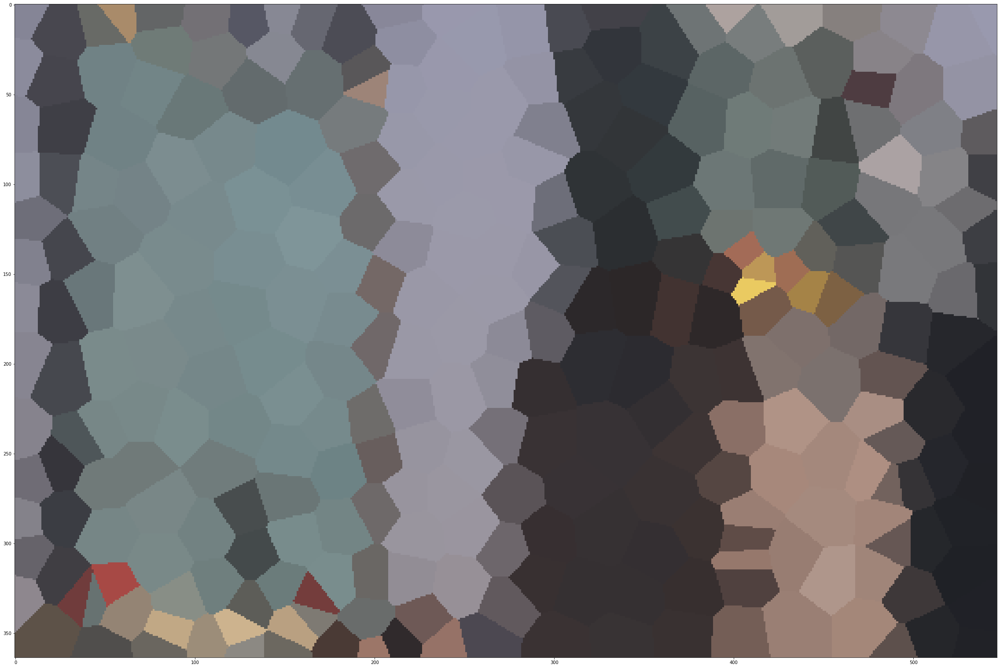

lable len: 292
preproc mask...
calculate area


/home/ekaterina/Work/environments/myvenv1/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning: overflow encountered in ubyte_scalars
/home/ekaterina/Work/environments/myvenv1/lib/python3.7/site-packages/ipykernel_launcher.py:98: RuntimeWarning: overflow encountered in ubyte_scalars
/home/ekaterina/Work/environments/myvenv1/lib/python3.7/site-packages/ipykernel_launcher.py:99: RuntimeWarning: overflow encountered in ubyte_scalars


calculate area
calculate area


Lossy conversion from int64 to uint8. Range [14, 416]. Convert image to uint8 prior to saving to suppress this warning.


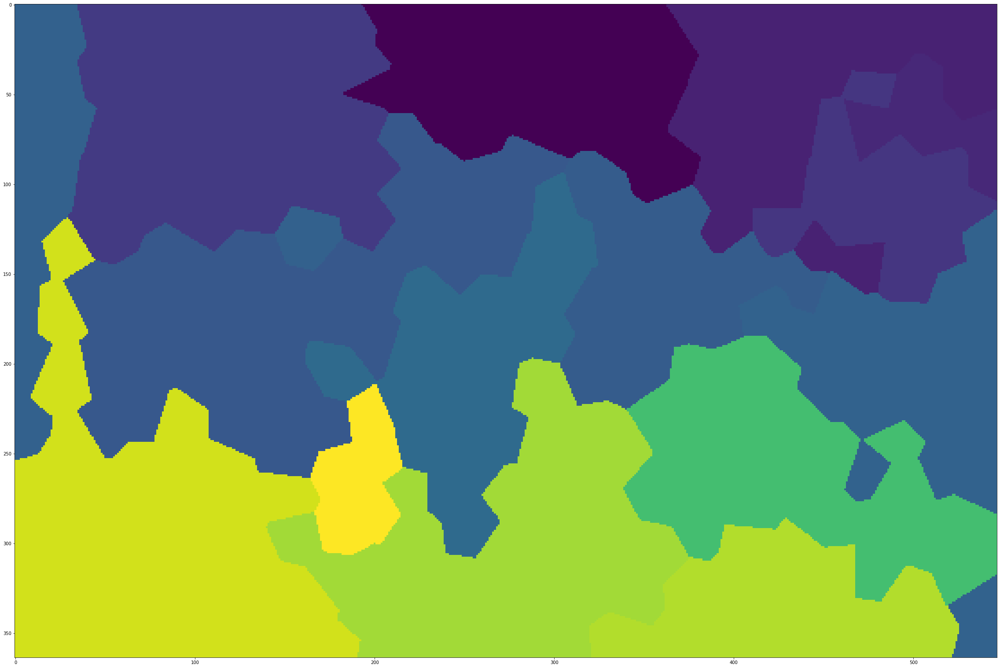

Transforme...


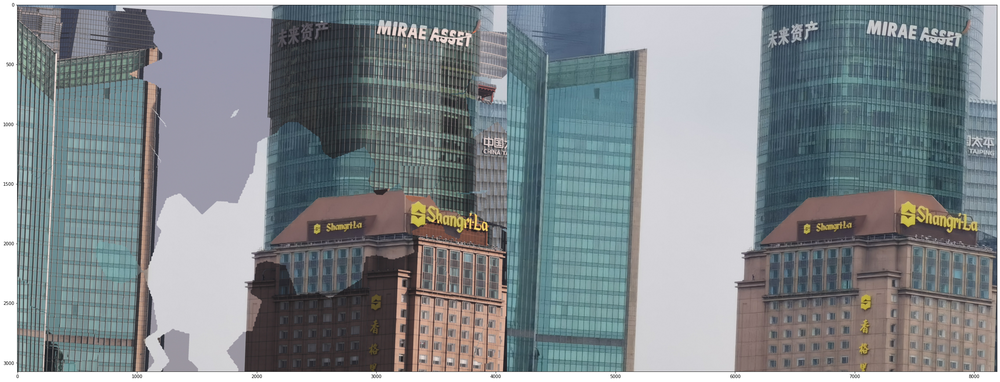

calculate mask...
Generated 1000 points.
Generated 2000 points.
Generated 2674 points.
Sampling colors...
Computing color means...
Downsampling 2674 to 300 points...
(364, 547, 3)
Rendering...
end render
(364, 547, 3)


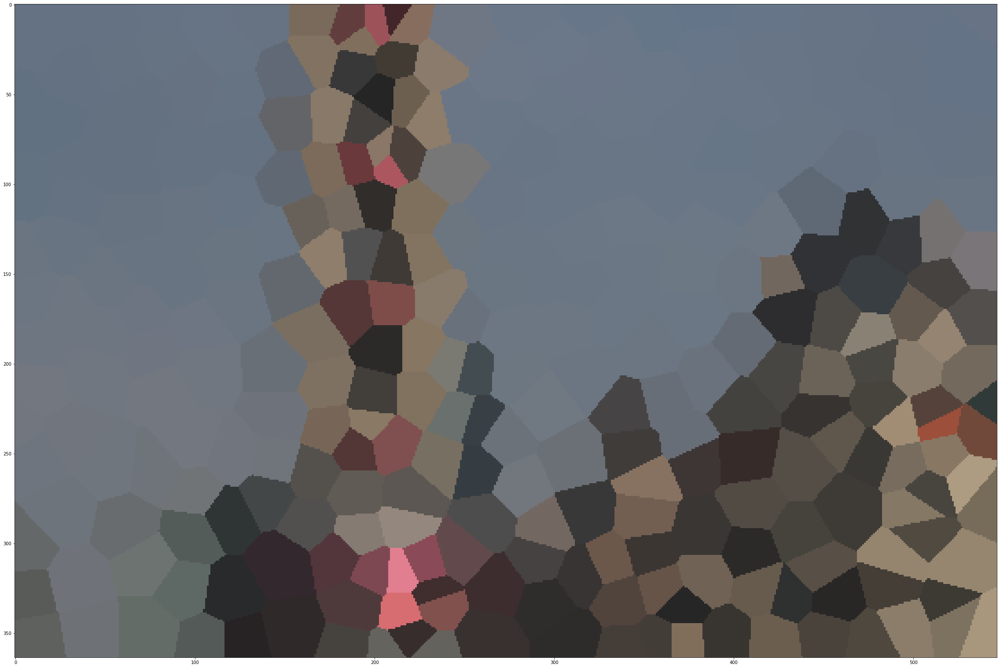

lable len: 272
preproc mask...
calculate area
calculate area
calculate area


Lossy conversion from int64 to uint8. Range [41, 526]. Convert image to uint8 prior to saving to suppress this warning.


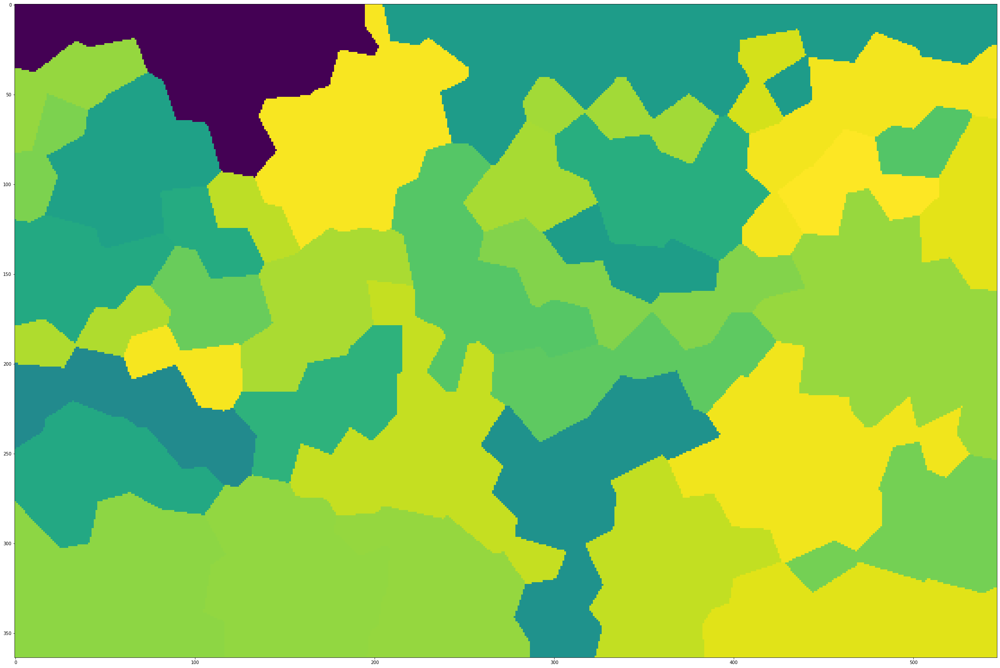

Transforme...


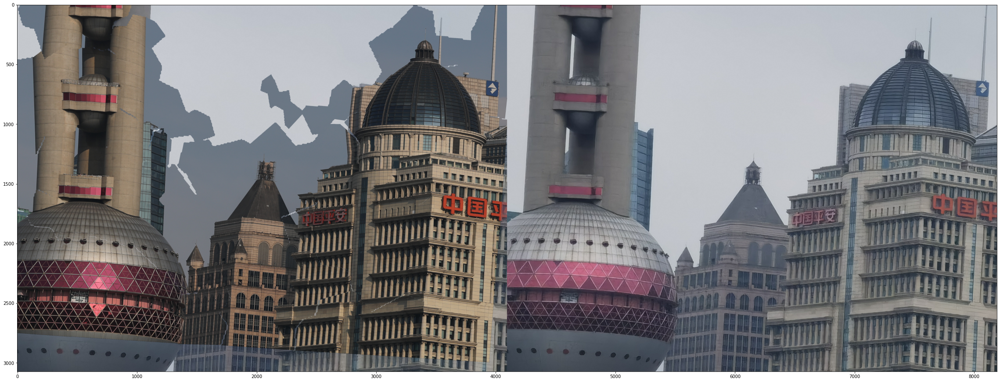

calculate mask...
Generated 1000 points.
Generated 2000 points.
Generated 2079 points.
Sampling colors...
Computing color means...
Downsampling 2079 to 300 points...
(364, 547, 3)
Rendering...
end render
(364, 547, 3)


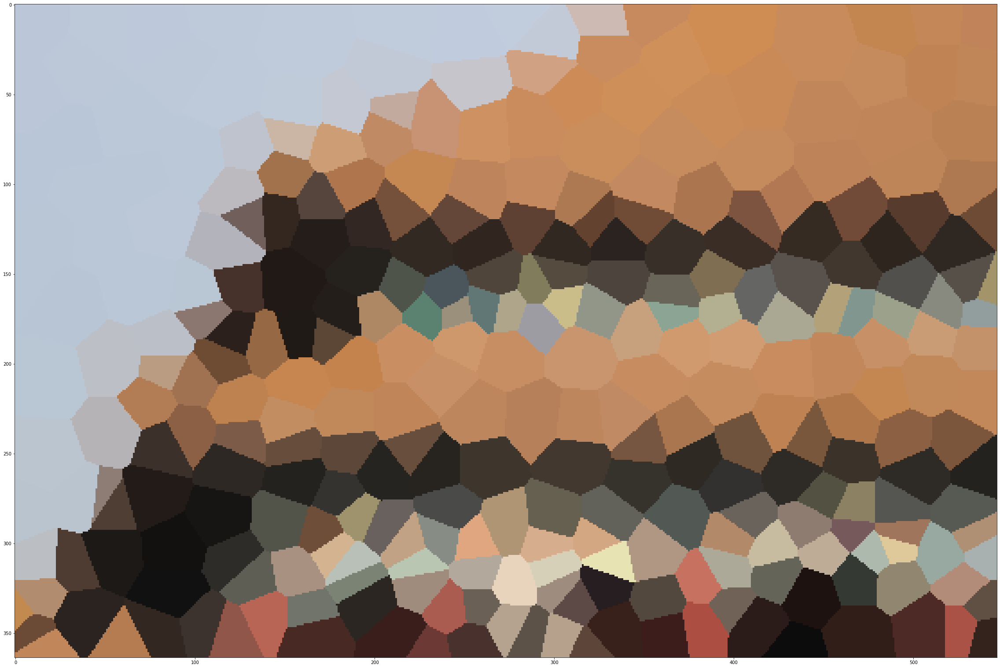

lable len: 291
preproc mask...
calculate area
calculate area
calculate area


Lossy conversion from int64 to uint8. Range [27, 558]. Convert image to uint8 prior to saving to suppress this warning.


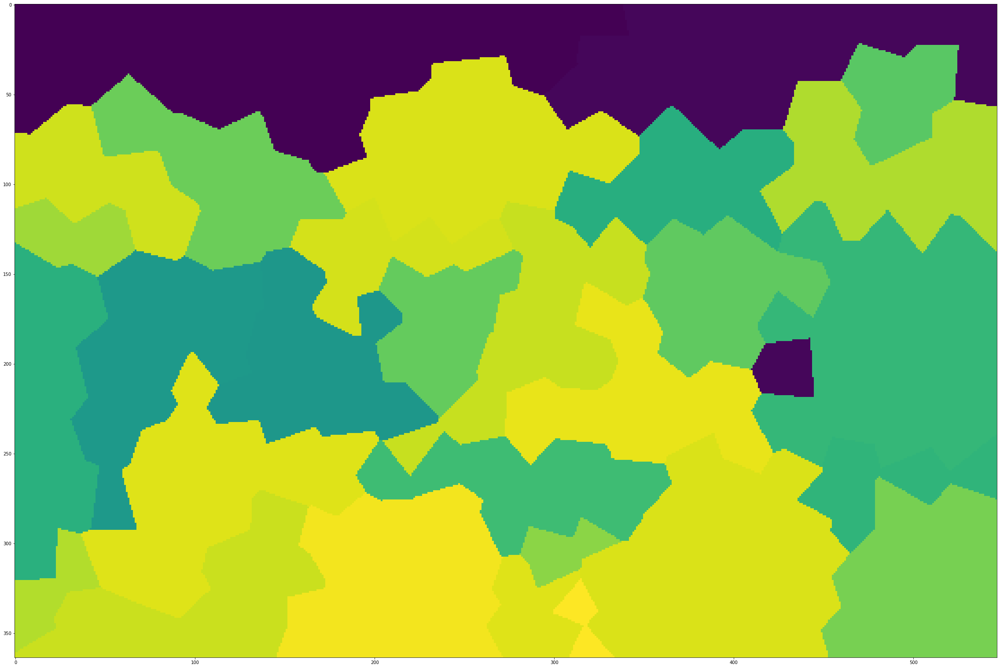

Transforme...


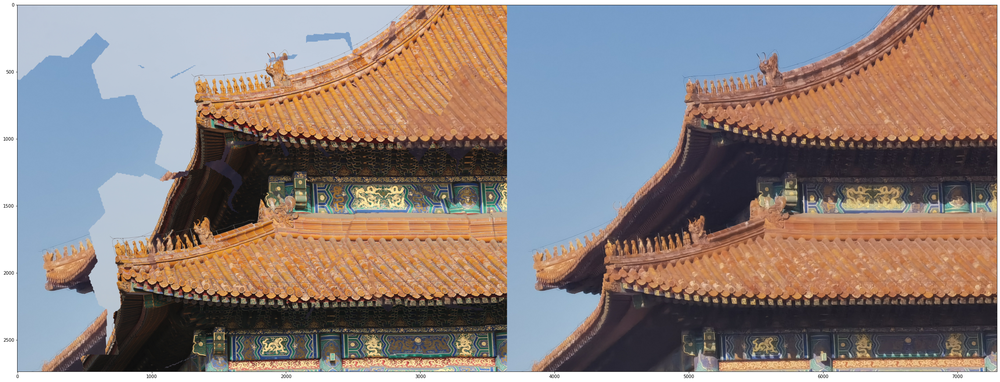

In [16]:
ind = 0
for imgs in imgs_list:

    image0, inp0, scales0 = read_image(input_dir + imgs[0], device, RESIZE, ROT0, RESIZE_FLOAT)
    image1, inp1, scales1 = read_image(input_dir + imgs[1], device, RESIZE, ROT1, RESIZE_FLOAT)
    
    pred = matching({'image0': inp0, 'image1': inp1,'image_path0':input_dir + imgs[0],'image_path1':input_dir + imgs[1]},1)
    pred = {k: v[0].cpu().numpy() for k, v in pred.items()}
    kpts0, kpts1 = pred['keypoints0'], pred['keypoints1']
    matches, conf = pred['matches0'], pred['matching_scores0']
    # Write the matches to disk.
    out_matches = {'keypoints0': kpts0, 'keypoints1': kpts1,
                   'matches': matches, 'match_confidence': conf}
    
    
    valid = (matches > -1) & (conf>0.75)
    mkpts0 = kpts0[valid]
    mkpts1 = kpts1[matches[valid]]
    
    image0 = cv2.imread(input_dir + imgs[0])[..., [2, 1, 0]]
    image1 = cv2.imread(input_dir + imgs[1])[..., [2, 1, 0]]
    
    mkpts0 *= scales0
    mkpts1 *= scales1
    
    transformed_image0 = pipeline(mkpts0, mkpts1, image0, image1)
    imageio.imwrite('image'+str(ind)+'.jpg',transformed_image0)
    
    plt.imshow(np.concatenate([transformed_image0,image0],axis=1))
    plt.show()
    ind+=1
    


calculate mask...
Generated 1000 points.
Generated 1142 points.
Sampling colors...
Computing color means...
Downsampling 1142 to 600 points...
(304, 456, 3)
Rendering...
end render
(304, 456, 3)


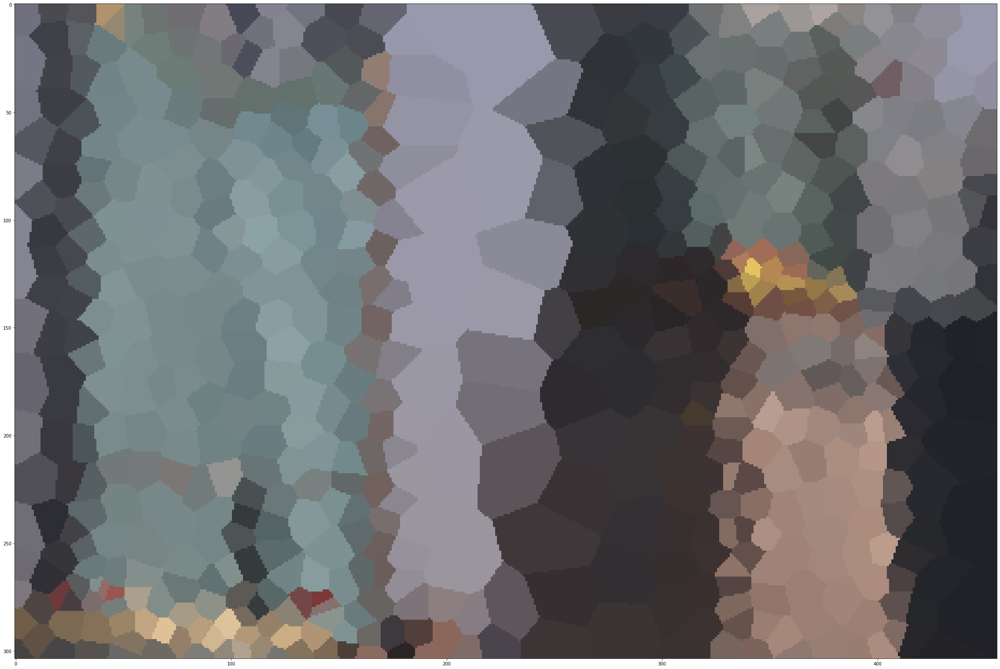

lable len: 586


Lossy conversion from int64 to uint8. Range [0, 585]. Convert image to uint8 prior to saving to suppress this warning.


preproc mask...


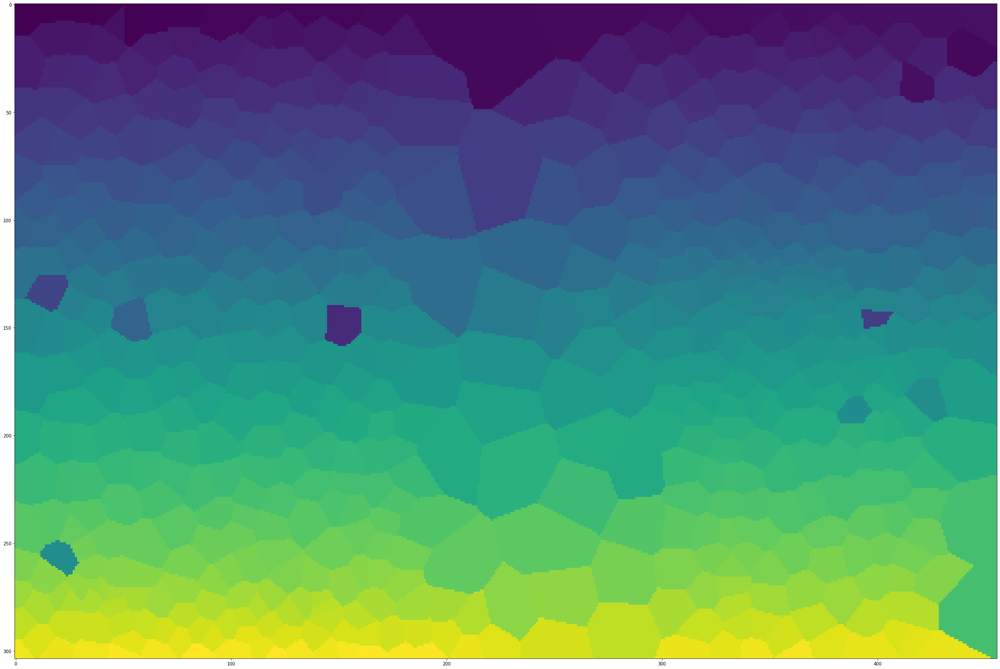

Transforme...


0
0
0
0
0
3
2
1
0
0
0
0
3
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
3
2
0
0
0
0
0
0
0
0
0
0
0
3
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
2
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
2
3
2
0
1
1
0
0
2
1
2
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0



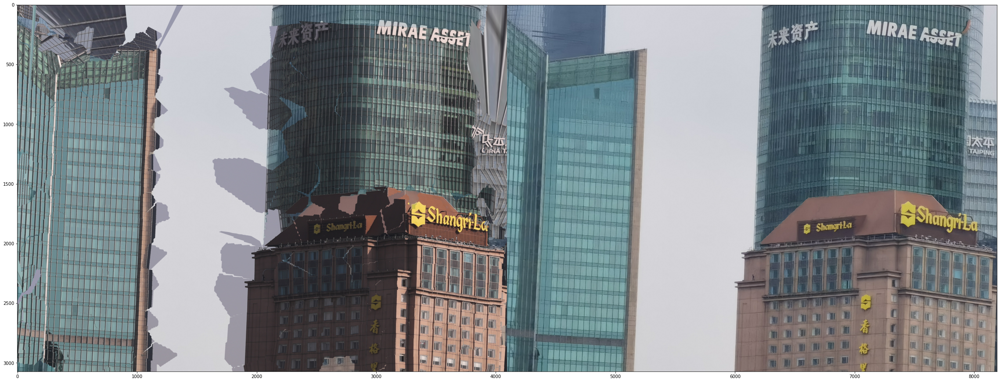

In [50]:
transformed_image0 = pipeline(mkpts0, mkpts1, image0, image1)
plt.imshow(np.concatenate([transformed_image0,image0],axis=1))
plt.show()

calculate mask...
Generated 1000 points.
Generated 1149 points.
Sampling colors...
Computing color means...
Downsampling 1149 to 600 points...
(304, 456, 3)
Rendering...
end render
(304, 456, 3)


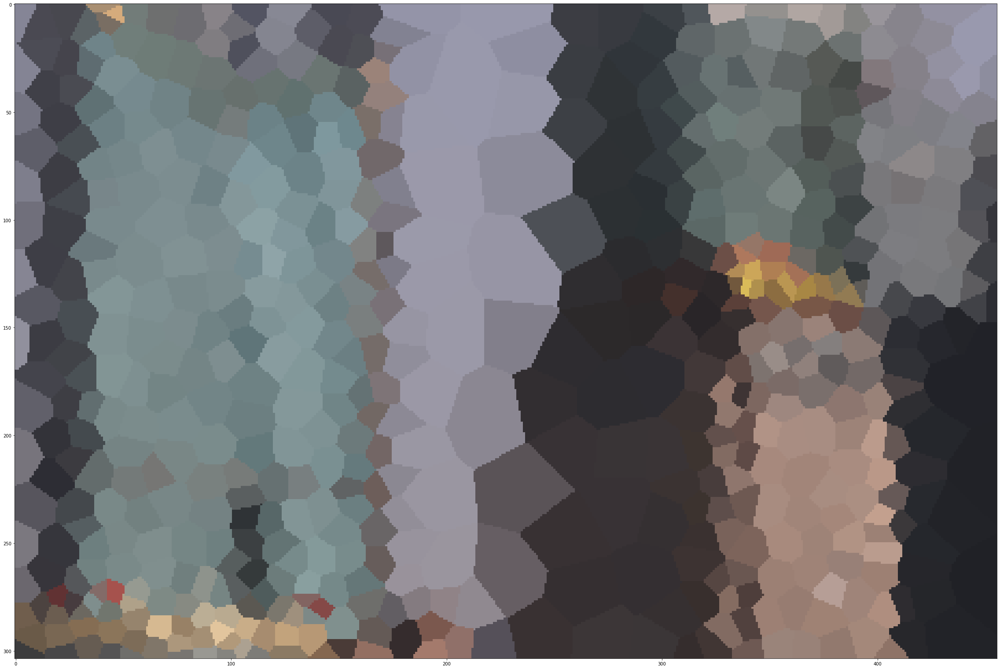

lable len: 578
preproc mask...
calculate area
calculate area
calculate area
calculate area
calculate area
calculate area
calculate area
calculate area
calculate area
calculate area


Lossy conversion from int64 to uint8. Range [594, 1090]. Convert image to uint8 prior to saving to suppress this warning.


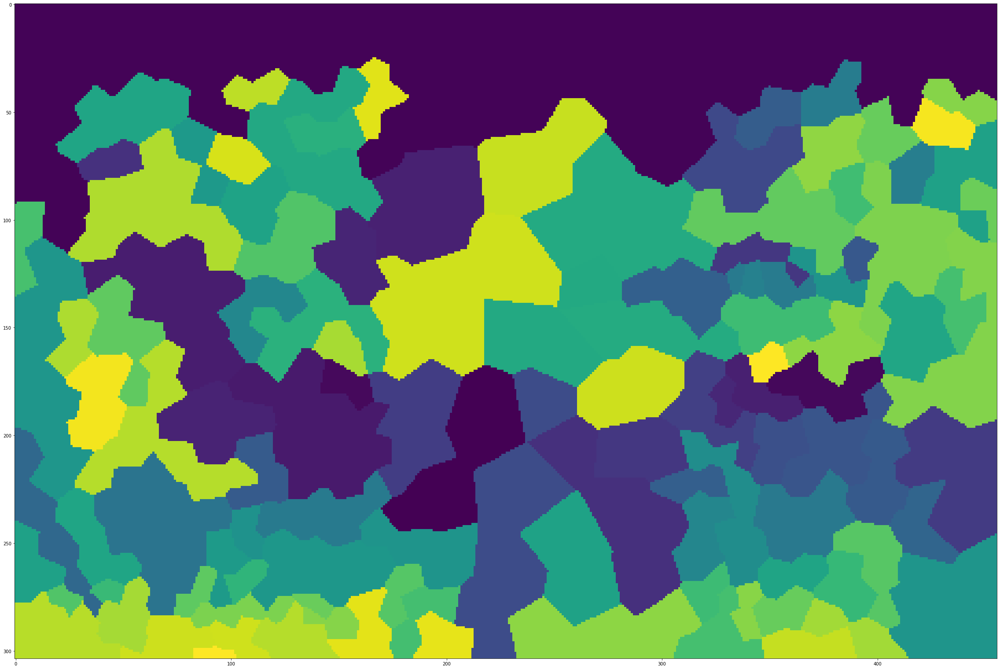

Transforme...


0
0
0
0
1
1
3
0
0
0
0
3
0
0
3
0
3
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0



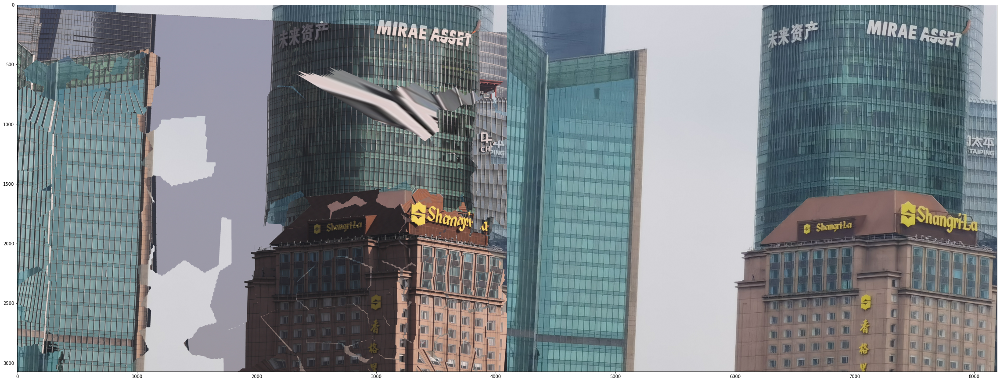

In [41]:
transformed_image0 = pipeline(mkpts0, mkpts1, image0, image1)
plt.imshow(np.concatenate([transformed_image0,image0],axis=1))
plt.show()


In [ ]:
def region_growing(img, seed):
    #Parameters for region growing
    neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    region_threshold = 0.2
    region_size = 1
    intensity_difference = 0
    neighbor_points_list = []
    neighbor_intensity_list = []

    #Mean of the segmented region
    region_mean = img[seed]

    #Input image parameters
    height, width = img.shape
    image_size = height * width

    #Initialize segmented output image
    segmented_img = np.zeros((height, width, 1), np.uint8)

    #Region growing until intensity difference becomes greater than certain threshold
    while (intensity_difference < region_threshold) & (region_size < image_size):
        #Loop through neighbor pixels
        for i in range(4):
            #Compute the neighbor pixel position
            x_new = seed[0] + neighbors[i][0]
            y_new = seed[1] + neighbors[i][1]

            #Boundary Condition - check if the coordinates are inside the image
            check_inside = (x_new >= 0) & (y_new >= 0) & (x_new < height) & (y_new < width)

            #Add neighbor if inside and not already in segmented_img
            if check_inside:
                if segmented_img[x_new, y_new] == 0:
                    neighbor_points_list.append([x_new, y_new])
                    neighbor_intensity_list.append(img[x_new, y_new])
                    segmented_img[x_new, y_new] = 255

        #Add pixel with intensity nearest to the mean to the region
        distance = abs(neighbor_intensity_list-region_mean)
        pixel_distance = min(distance)
        index = np.where(distance == pixel_distance)[0][0]
        segmented_img[seed[0], seed[1]] = 255
        region_size += 1

        #New region mean
        region_mean = (region_mean*region_size + neighbor_intensity_list[index])/(region_size+1)

        #Update the seed value
        seed = neighbor_points_list[index]
        #Remove the value from the neighborhood lists
        neighbor_intensity_list[index] = neighbor_intensity_list[-1]
        neighbor_points_list[index] = neighbor_points_list[-1]

    return segmented_img

In [15]:
image_test = cv2.imread('/home/ekaterina/Work/find_new/marked_mask.png')[..., [2, 1, 0]]

In [14]:
segm_img = region_growing(image_test)

AttributeError: module 'cv2.cv2' has no attribute 'createStereoBM'

In [27]:
np.unique(image_test.reshape(-1,3), axis=1).shape

(199108, 3)

In [23]:
image_test.reshape(-1,3).shape

(199108, 3)

In [72]:
image = cv2.resize(image1,(image1.shape[1]//12,image1.shape[0]//12))
sample_points = poisson_disc(image, 600)
samples = sample_colors(image, sample_points,600)

mask_img = (render(image, samples)*255.).astype(np.uint8)

Generated 1000 points.
Generated 1153 points.
Sampling colors...
Computing color means...
Downsampling 1153 to 600 points...
Rendering...


In [73]:
lable_unique = []
test_im = mask_img.reshape(-1,3).tolist()
for i in range(len(test_im)):

    if i==0:
        lable_unique.append(test_im[i])
    elif test_im[i] not in lable_unique:
        lable_unique.append(test_im[i])
        


In [74]:
len(lable_unique)

586

In [ ]:
test_im[0,0]

In [88]:
x= [2,34,4,7,2]

In [89]:
xx = np.array(x)

In [90]:
np.sort(xx)

array([ 2,  2,  4,  7, 34])